In [1]:
import numpy as np
import roomacoustics.analytic as analytic

import matplotlib.pyplot as plt


In [2]:
L = np.array([8, 5, 3])/10
zetas = np.ones((3, 2)) * 10

c = 343.9

r_R = np.array([3.3, 1.6, 1.8])/10
r_S = np.array([5.3, 3.6, 1.2])/10



samplingrate = 4e3
f_max = samplingrate/2*0.95
n_samples = 2**10
freqs = np.fft.rfftfreq(n_samples, 1/samplingrate)
ks = 2*np.pi*freqs/c

In [3]:
k_ns, mode_idx = analytic.eigenfrequencies_rectangular_room_impedance(
    L, ks, f_max*2*np.pi/c, zetas, only_normal=True)

In [4]:
mask = np.prod(np.array([0,0,0]) == mode_idx, axis=-1) == 1

In [5]:
rir, spec, k_ns = analytic.rectangular_room_impedance(
    L, r_S, r_R, zetas, f_max, samplingrate, c, n_samples, remove_cavity_mode=False)

[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done   2 out of   2 | elapsed:    0.4s finished


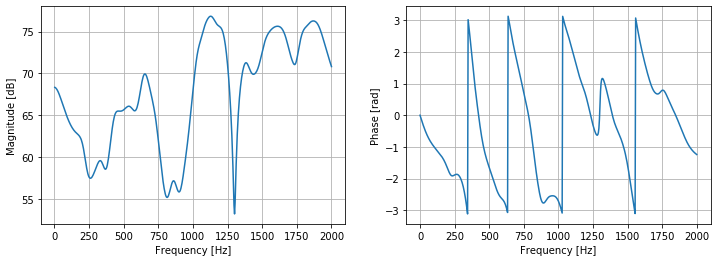

In [6]:
plt.figure(figsize=(12, 4))
plt.subplot(1,2,1)
plt.plot(freqs, 20*np.log10(np.abs(spec)))
ax = plt.gca()
ax.set_ylabel("Magnitude [dB]")
ax.set_xlabel("Frequency [Hz]")
plt.grid(True)
plt.subplot(1,2,2)
plt.plot(freqs, (np.angle(spec)))
plt.grid(True)
ax = plt.gca()
ax.set_ylabel("Phase [rad]")
ax.set_xlabel("Frequency [Hz]");

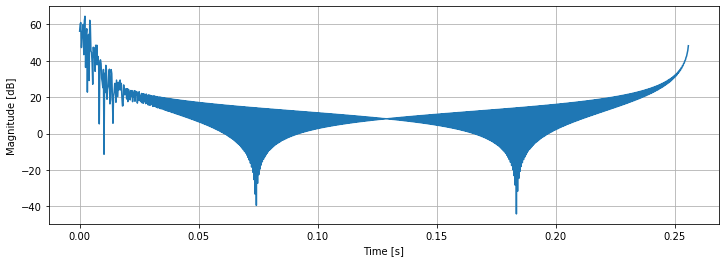

In [7]:
times = np.arange(0, n_samples)/samplingrate

plt.figure(figsize=(12, 4))
plt.plot(times, 20*np.log10(np.abs(rir)))
ax = plt.gca()
ax.set_ylabel("Magnitude [dB]")
ax.set_xlabel("Time [s]")
plt.grid(True)

In [8]:
# np.save('../data/analytic_rtf_impedance.npy', spec)
# np.save('../data/analytic_rir_impedance.npy', rir)

In [9]:
rir_rem, spec_rem, k_ns_rem = analytic.rectangular_room_impedance(
    L, r_S, r_R, zetas, f_max, samplingrate, c, n_samples, remove_cavity_mode=True)

[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done   2 out of   2 | elapsed:    0.4s finished


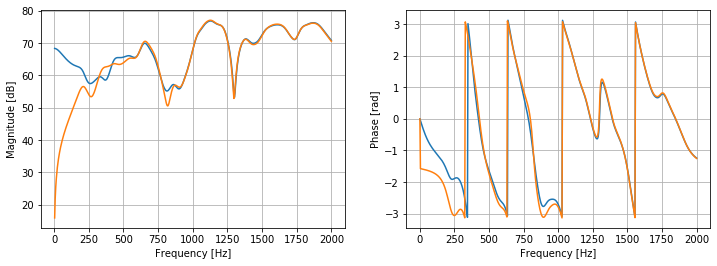

In [10]:
plt.figure(figsize=(12, 4))
plt.subplot(1,2,1)
plt.plot(freqs, 20*np.log10(np.abs(spec)))
plt.plot(freqs, 20*np.log10(np.abs(spec_rem)))
ax = plt.gca()
ax.set_ylabel("Magnitude [dB]")
ax.set_xlabel("Frequency [Hz]")
plt.grid(True)
plt.subplot(1,2,2)
plt.plot(freqs, (np.angle(spec)))
plt.plot(freqs, (np.angle(spec_rem)))
plt.grid(True)
ax = plt.gca()
ax.set_ylabel("Phase [rad]")
ax.set_xlabel("Frequency [Hz]");

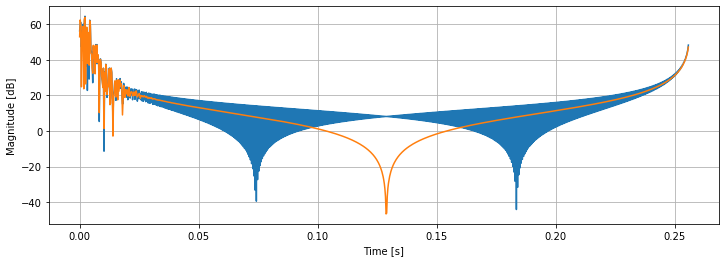

In [11]:
times = np.arange(0, n_samples)/samplingrate

plt.figure(figsize=(12, 4))
plt.plot(times, 20*np.log10(np.abs(rir)))
plt.plot(times, 20*np.log10(np.abs(rir_rem)))
ax = plt.gca()
ax.set_ylabel("Magnitude [dB]")
ax.set_xlabel("Time [s]")
plt.grid(True)

In [12]:
# np.save('../data/analytic_rtf_impedance_no_cav.npy', spec_rem)
# np.save('../data/analytic_rir_impedance_no_cav.npy', rir_rem)

In [13]:

derivatives = np.array([
    [0, 0, 0],
    [1, 0, 0],
    [0, 1, 0],
    [0, 0, 1]
])

In [14]:
zetas = np.ones((3, 2, 513)) * 1e10
h_x = analytic.multipoles_modal_superposition(
    ks, ks*c, k_ns, mode_idx, r_R, r_S, L, zetas, derivatives)

In [15]:
h_x.shape

(4, 513)

In [16]:
velocity = h_x[1:4] * -1/(freqs*2*np.pi*1.2)

In [17]:
intensity = np.real(h_x[0] * velocity.conj())/2

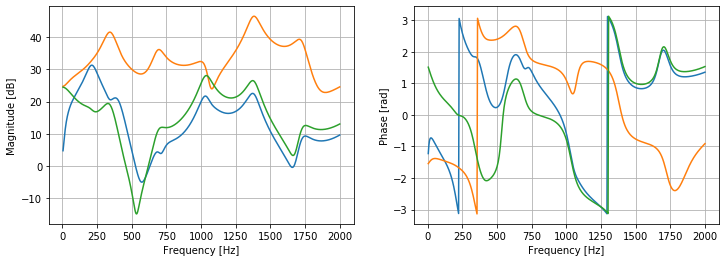

In [18]:
plt.figure(figsize=(12, 4))
plt.subplot(1,2,1)
plt.plot(freqs, 20*np.log10(np.abs(velocity.T)))
ax = plt.gca()
ax.set_ylabel("Magnitude [dB]")
ax.set_xlabel("Frequency [Hz]")
plt.grid(True)
plt.subplot(1,2,2)
plt.plot(freqs, (np.angle(velocity.T)))
plt.grid(True)
ax = plt.gca()
ax.set_ylabel("Phase [rad]")
ax.set_xlabel("Frequency [Hz]");

In [19]:
res_R = 10
x_R = np.linspace(0.01, L[0]-0.01, res_R)
y_R = np.linspace(0.01, L[1]-0.01, res_R)
r_R_x, r_R_y = np.meshgrid(x_R, y_R)


In [20]:
r_R_z = np.ones(res_R**2)

In [21]:
r_R = np.vstack((r_R_x.flatten(), r_R_y.flatten(), r_R_z.flatten())).T
r_R.shape

(100, 3)

In [22]:

zetas = np.ones((3, 2, 513)) * 1e10
h_x = analytic.multipoles_modal_superposition(
    ks, ks*c, k_ns, mode_idx, r_R, r_S, L, zetas)

In [23]:
h_x.shape

(100, 513)

In [24]:
velocity = h_x[1:] * 1/(1j*freqs*2*np.pi*1.2)

In [25]:
intensity = np.real(h_x[0] * velocity.conj())/2
intensity_reactive = np.imag(h_x[0] * velocity.conj())/2

In [26]:

from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import
fig = plt.figure(figsize=(12, 4))
ax_re = plt.subplot(1,2,1, projection='3d')
ax_im = plt.subplot(1,2,2, projection='3d')

ax_re.quiver(
    r_R_x.flatten(),
    r_R_y.flatten(),
    r_R_z.flatten(),
    np.nanmean(intensity[0, :, :], axis=-1),
    np.nanmean(intensity[1, :, :], axis=-1),
    np.nanmean(intensity[2, :, :], axis=-1),
    length=0.05,
    normalize=True)

ax_im.quiver(
    r_R_x.flatten(),
    r_R_y.flatten(),
    r_R_z.flatten(),
    np.nanmean(intensity_reactive[0, :, :], axis=-1),
    np.nanmean(intensity_reactive[1, :, :], axis=-1),
    np.nanmean(intensity_reactive[2, :, :], axis=-1),
    length=0.05,
    normalize=True)

IndexError: too many indices for array

In [ ]:
import spharpy


In [260]:

def number_multipoles(multipole_order):
    num_multipoles = np.int(
        (multipole_order+1)*(multipole_order+2)*(multipole_order+3)/6)
    return num_multipoles

def multipole_index(multipole_order):

    num_multipoles = number_multipoles(multipole_order)

    orders = np.arange(0, multipole_order+1)
    combs = np.meshgrid(orders, orders, orders)

    perms = np.array(combs).T.reshape(-1, 3)
    mask_trunc_order = perms.sum(axis=-1) <= multipole_order
    perms = perms[mask_trunc_order]

    if num_multipoles != perms.shape[0]:
        raise ValueError("Index array does not match the expected number of multipoles.")

    index_sort = np.argsort(perms.sum(axis=-1))
    perms = perms[index_sort]

    for order in range(multipole_order+1):
        mask_order = np.sum(perms, axis=-1) == order
        index_lexsort = np.lexsort(perms[mask_order].T)
        perms[mask_order] = perms[mask_order][index_lexsort]

    return perms


def multipole_derivative(multipole_order,coords):
    """ see Zotter/Ureta Staackmann eq. (4):
    
    .. math::
        M_{lmn}=\theta_x^l\theta_y^m\theta_z^n
        
    Parameters
    ----------
    multipole_order: integer
        Maximum multipole order
    coords: Coordinates
        Coordinate object containing the points at which the multipole derivatives a computed, centered in the origin

    Returns
    -------
    M : ndarray, complex double
        matrix of size (n_points)x((n_mp+1)*(n_mp+2)*(n_mp+3)/6) containing the multipole coefficients for the given coordinates
    """
    # theta_x = coords.x/coords.radius
    # theta_y = coords.y/coords.radius
    # theta_z = coords.z/coords.radius

    # theta = coords.cartesian / coords.radius
    
    # ind_max = number_multipoles(multipole_order)
    
    # # Initialization
    # M = np.zeros((coords.n_points,ind_max), dtype=np.double)

    # indices = multipole_index(multipole_order)
    
    # for ind in np.arange(ind_max):
    #     # compute every column in M
    #     l,m,n = ind2lmn(ind)
    #     M[:,ind] = theta_x**l*theta_y**m*theta_z**n

    # return M
    # multipole_order = 2
    theta = np.atleast_2d(sampling.cartesian / sampling.radius).T
    num_multipoles = number_multipoles(multipole_order)
    indices = multipole_index(multipole_order)

    M = np.zeros((sampling.n_points, num_multipoles), dtype=np.double)

    for linear_index, multi_index in enumerate(indices):
        M[:, linear_index] = np.prod([
            theta[:, 0] ** multi_index[0], 
            theta[:, 1] ** multi_index[1],
            theta[:, 2] ** multi_index[2]
        ], axis=0)

    return M


In [310]:
multi_order = 6
sampling = spharpy.samplings.spherical_t_design(multi_order*4)
indices = multipole_index(multi_order)

In [283]:
import spharpy

In [311]:
Y = spharpy.spherical.spherical_harmonic_basis_real(multi_order, sampling)

In [312]:
M = multipole_derivative(multi_order, sampling)

In [313]:
C = np.linalg.pinv(Y) @ M
C = Y.T * 4*np.pi/sampling.n_points @ M

<Figure size 1152x720 with 0 Axes>

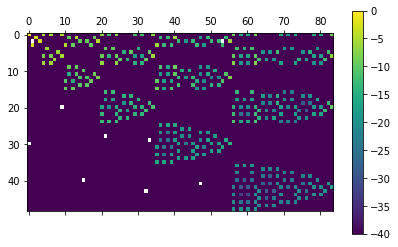

In [314]:

plt.figure(figsize=(16, 10))
# plt.matshow(10*np.log10(np.abs(C)), clim=(-40, 0))
plt.matshow(10*np.log10(np.abs(C)/np.abs(C).max()), clim=(-40, 0))
plt.colorbar()

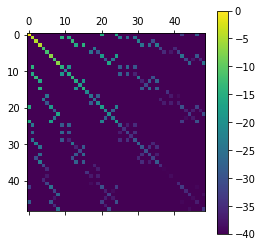

In [315]:
G = C @ C.T
plt.matshow(10*np.log10(np.abs(G/G.max())), clim=(-40, 0))
plt.colorbar()

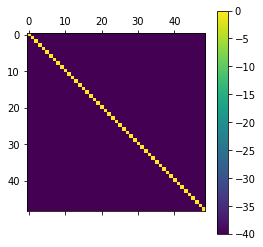

In [316]:

G = C @ np.linalg.pinv(C)
plt.matshow(10*np.log10(np.abs(G/G.max())), clim=(-40, 0))
plt.colorbar()

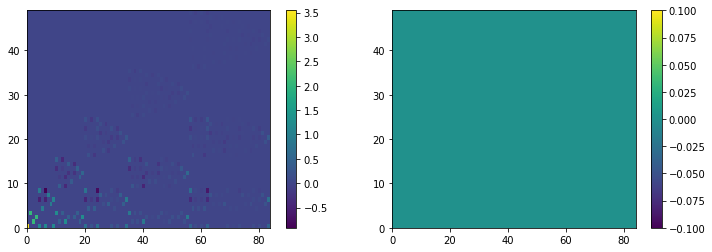

In [317]:
plt.figure(figsize=(12, 4))
ax = plt.subplot(1, 2, 1)
# plt.matshow(10*np.log10(np.abs(C)), clim=(-40, 0))
plt.pcolormesh(np.real(C))
plt.colorbar()
ax = plt.subplot(1, 2, 2)
plt.pcolormesh(np.imag(C))
plt.colorbar()

In [290]:
zetas = np.ones((3, 2, 513)) * 1e10
h_x = analytic.multipoles_modal_superposition(
    ks, ks*c, k_ns, mode_idx, r_R, r_S, L, zetas, derivatives=indices)

In [291]:
h_sh = np.matmul(C, h_x[:, 10, :])

In [292]:
h_sh.shape

(49, 513)

In [318]:
steering = spharpy.samplings.equalarea(22, condition_num=np.inf)

In [319]:
Y_bf = 4*np.pi/(multi_order+1)**2 * spharpy.spherical.spherical_harmonic_basis_real(multi_order, steering)
pwd = Y_bf @ h_sh

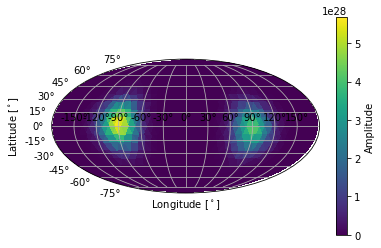

In [320]:
spharpy.plot.pcolor_map(steering, np.sum(np.abs(pwd)**2, axis=-1))

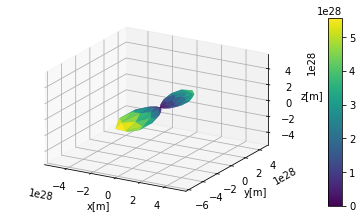

In [321]:
spharpy.plot.balloon(steering, np.sum(np.abs(pwd)**2, axis=-1))

In [322]:
M.shape

(1202, 84)

In [323]:

# G = np.exp(-1j*wave_num*coords.radius)/(4*np.pi*coords.radius)
G = np.exp(-1j*sampling.radius)/(4*np.pi*sampling.radius)

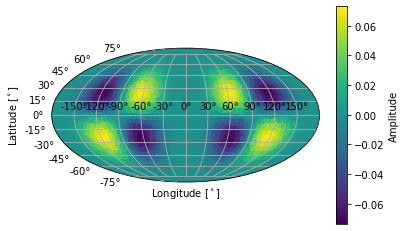

In [363]:
spharpy.plot.pcolor_map(sampling, M[:, 67])

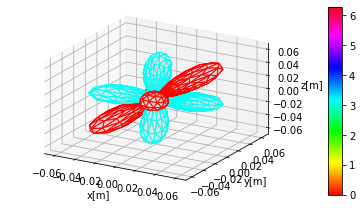

In [362]:
spharpy.plot.balloon_wireframe(sampling, M[:, 67], phase=True)